# Multicollinearity of Features - Lab

## Introduction

In this lab you'll identify multicollinearity in the Boston Housing Data set.

## Objectives
You will be able to:
* Plot heatmaps for the predictors of the Boston dataset
* Understand and calculate correlation matrices

## Correlation matrix for the Boston Housing data

Let's reimport the Boston Housing data and let's use the data with the categorical variables for `tax_dummy` and `rad_dummy`

In [1]:
import pandas as pd
from sklearn.datasets import load_boston
boston = load_boston()

boston_features = pd.DataFrame(boston.data, columns = boston.feature_names)

# first, create bins for based on the values observed. 5 values will result in 4 bins
bins = [0, 3, 4 , 5, 24]
bins_rad = pd.cut(boston_features['RAD'], bins)
bins_rad = bins_rad.cat.as_unordered()

# first, create bins for based on the values observed. 5 values will result in 4 bins
bins = [0, 250, 300, 360, 460, 712]
bins_tax = pd.cut(boston_features['TAX'], bins)
bins_tax = bins_tax.cat.as_unordered()

tax_dummy = pd.get_dummies(bins_tax, prefix="TAX")
rad_dummy = pd.get_dummies(bins_rad, prefix="RAD")
boston_features = boston_features.drop(["RAD","TAX"], axis=1)
boston_features = pd.concat([boston_features, rad_dummy, tax_dummy], axis=1)

In [2]:
boston_features.head()

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,PTRATIO,B,LSTAT,"RAD_(0, 3]","RAD_(3, 4]","RAD_(4, 5]","RAD_(5, 24]","TAX_(0, 250]","TAX_(250, 300]","TAX_(300, 360]","TAX_(360, 460]","TAX_(460, 712]"
0,0.00632,18.0,2.31,0.0,0.538,6.575,65.2,4.0900,15.3,396.90,4.98,1,0,0,0,0,1,0,0,0
1,0.02731,0.0,7.07,0.0,0.469,6.421,78.9,4.9671,17.8,396.90,9.14,1,0,0,0,1,0,0,0,0
2,0.02729,0.0,7.07,0.0,0.469,7.185,61.1,4.9671,17.8,392.83,4.03,1,0,0,0,1,0,0,0,0
3,0.03237,0.0,2.18,0.0,0.458,6.998,45.8,6.0622,18.7,394.63,2.94,1,0,0,0,1,0,0,0,0
4,0.06905,0.0,2.18,0.0,0.458,7.147,54.2,6.0622,18.7,396.90,5.33,1,0,0,0,1,0,0,0,0


## Scatter matrix

Create the scatter matrix for the Boston Housing data.

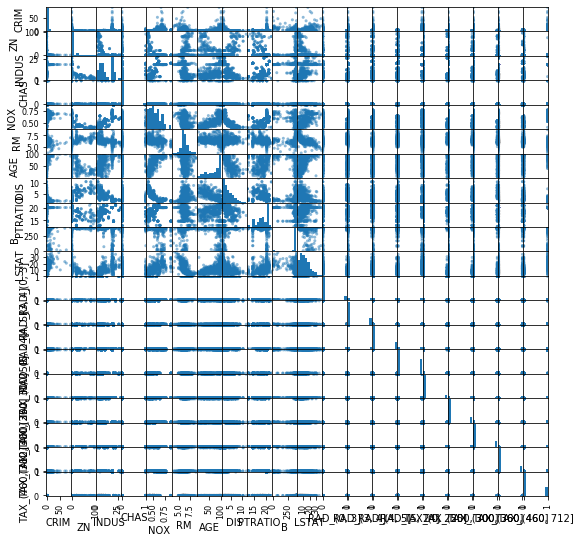

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline

pd.plotting.scatter_matrix(boston_features, figsize=(9, 9));
plt.show()

This took a while to load. Not surprisingly, the categorical variables didn't really provide any meaningful result. remove the categorical columns associated with "RAD" and "TAX" from the data again and look at the scatter matrix again.

In [4]:
to_drop = []
for index, col in enumerate(boston_features.columns):
    if col[0:3]=='RAD' or col[0:3]=='TAX':
        to_drop.append(col)
boston_features.drop(to_drop, axis=1, inplace=True)

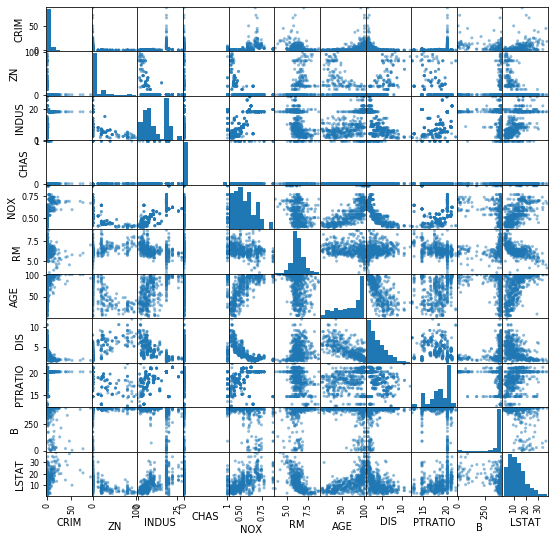

In [5]:
pd.plotting.scatter_matrix(boston_features, figsize=(9, 9));
plt.show()

## Correlation matrix

Next, let's look at the correlation matrix

In [6]:
bf_corr = boston_features.corr()
bf_corr

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,PTRATIO,B,LSTAT
CRIM,1.000000,-0.200469,0.406583,-0.055892,0.420972,-0.219247,0.352734,-0.379670,0.289946,-0.385064,0.455621
ZN,-0.200469,1.000000,-0.533828,-0.042697,-0.516604,0.311991,-0.569537,0.664408,-0.391679,0.175520,-0.412995
INDUS,0.406583,-0.533828,1.000000,0.062938,0.763651,-0.391676,0.644779,-0.708027,0.383248,-0.356977,0.603800
CHAS,-0.055892,-0.042697,0.062938,1.000000,0.091203,0.091251,0.086518,-0.099176,-0.121515,0.048788,-0.053929
NOX,0.420972,-0.516604,0.763651,0.091203,1.000000,-0.302188,0.731470,-0.769230,0.188933,-0.380051,0.590879
RM,-0.219247,0.311991,-0.391676,0.091251,-0.302188,1.000000,-0.240265,0.205246,-0.355501,0.128069,-0.613808
AGE,0.352734,-0.569537,0.644779,0.086518,0.731470,-0.240265,1.000000,-0.747881,0.261515,-0.273534,0.602339
DIS,-0.379670,0.664408,-0.708027,-0.099176,-0.769230,0.205246,-0.747881,1.000000,-0.232471,0.291512,-0.496996
PTRATIO,0.289946,-0.391679,0.383248,-0.121515,0.188933,-0.355501,0.261515,-0.232471,1.000000,-0.177383,0.374044
B,-0.385064,0.175520,-0.356977,0.048788,-0.380051,0.128069,-0.273534,0.291512,-0.177383,1.000000,-0.366087


Return "True" for positive or negative correlations that are bigger than 0.75.

CRIM     ZN  INDUS   CHAS    NOX     RM    AGE    DIS  PTRATIO  \
CRIM      True  False  False  False  False  False  False  False    False   
ZN       False   True  False  False  False  False  False  False    False   
INDUS    False  False   True  False   True  False  False  False    False   
CHAS     False  False  False   True  False  False  False  False    False   
NOX      False  False   True  False   True  False  False   True    False   
RM       False  False  False  False  False   True  False  False    False   
AGE      False  False  False  False  False  False   True  False    False   
DIS      False  False  False  False   True  False  False   True    False   
PTRATIO  False  False  False  False  False  False  False  False     True   
B        False  False  False  False  False  False  False  False    False   
LSTAT    False  False  False  False  False  False  False  False    False   

             B  LSTAT  
CRIM     False  False  
ZN       False  False  
INDUS    False  False  
C

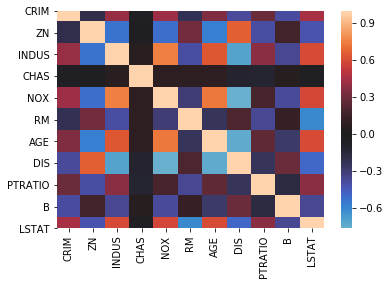

In [7]:
bf_corr_bool = abs(bf_corr) > 0.75
print(bf_corr_bool)

import seaborn as sns
sns.heatmap(bf_corr, center=0);

Remove the most problematic feature from the data.

to drop:  ['INDUS', 'NOX', 'DIS']
             CRIM        ZN      CHAS        RM       AGE   PTRATIO         B  \
CRIM     1.000000 -0.200469 -0.055892 -0.219247  0.352734  0.289946 -0.385064   
ZN      -0.200469  1.000000 -0.042697  0.311991 -0.569537 -0.391679  0.175520   
CHAS    -0.055892 -0.042697  1.000000  0.091251  0.086518 -0.121515  0.048788   
RM      -0.219247  0.311991  0.091251  1.000000 -0.240265 -0.355501  0.128069   
AGE      0.352734 -0.569537  0.086518 -0.240265  1.000000  0.261515 -0.273534   
PTRATIO  0.289946 -0.391679 -0.121515 -0.355501  0.261515  1.000000 -0.177383   
B       -0.385064  0.175520  0.048788  0.128069 -0.273534 -0.177383  1.000000   
LSTAT    0.455621 -0.412995 -0.053929 -0.613808  0.602339  0.374044 -0.366087   

            LSTAT  
CRIM     0.455621  
ZN      -0.412995  
CHAS    -0.053929  
RM      -0.613808  
AGE      0.602339  
PTRATIO  0.374044  
B       -0.366087  
LSTAT    1.000000  
          CRIM     ZN   CHAS     RM    AGE  PTRATIO     

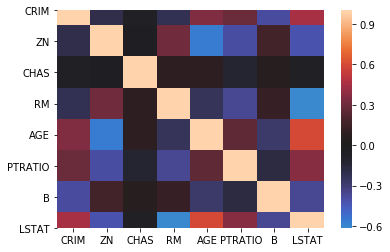

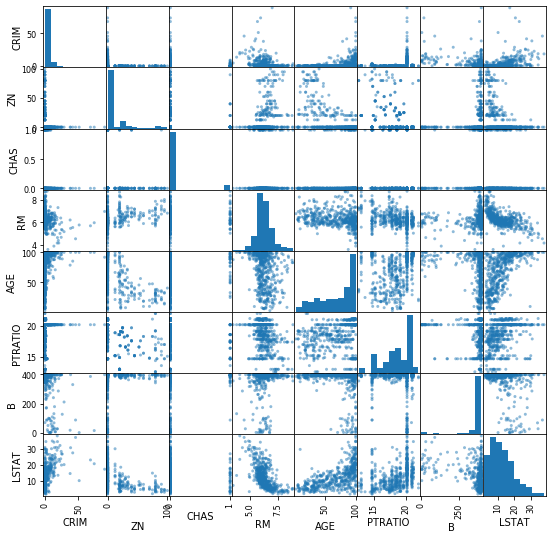

In [8]:
to_drop = set()
for index, col in enumerate(bf_corr_bool.columns):
    bf_corr_bool_counts = bf_corr_bool[col].value_counts()
    if bf_corr_bool_counts[1] > 1:  # then we have a pair-wise correlation > 0.75
        for c in list(bf_corr_bool[bf_corr_bool[col]==True].index):
            to_drop.add(c)    
to_drop = list(to_drop)
print("to drop: ", to_drop)
boston_features = boston_features.drop(to_drop, axis=1)

bf_corr = boston_features.corr()
print(bf_corr)
bf_corr_bool = abs(bf_corr) > 0.75
print(bf_corr_bool)
sns.heatmap(bf_corr, center=0);

pd.plotting.scatter_matrix(boston_features, figsize=(9, 9));
plt.show()

## Summary
Good job! You've now edited the Boston Housing Data so highly correlated variables are removed.